# Introduction: Optimizing Cost Efficiency for Project Wolbachia Implementation

## Problem Statement

Dengue fever is a disease caused by the dengue virus which is transmitted to humans via the bite of an infective mosquito. First-time dengue infections can be severe, especially among the elderly and those with pre-existing medical conditions, and repeat dengue infections have been associated with a higher occurrence of severe dengue involving dengue haemorrhagic fever(DHF) and dengue shock syndrome can be fatal. The risk of dengue has been [persistent](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC6085773/#:~:text=The%20first%20outbreak%20of%20dengue,Singapore%20was%20reported%20in%201901.&text=An%20outbreak%20of%20dengue%20hemorrhagic,cases%20was%20recorded%20in%201960.&text=Following%20then%2C%20large%20epidemics%20occurred,mostly%20the%20pediatric%20age%20group.) and [costly](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC10021432/#:~:text=We%20estimated%20that%20the%20average,21%2C262%20DALYs%20from%202010%E2%80%932020.) especially to a tropical country like Singapore which might face more severe consequences with the effects of climate change.

NEA have launched several vector control methods to reduce cases of dengue such as public awareness campaigns, fogging, neighbourhood inspections and [Project Wolbachia](https://www.nea.gov.sg/corporate-functions/resources/research/wolbachia-aedes-mosquito-suppression-strategy). Project Wolbachia have been a promising and successful project through the release of Wolbachia infected mosquito to suppress and replace the Aedes population. However, it have been [costly and labour intensive to carry out](https://www.channelnewsasia.com/watch/project-wolbachia-sees-success-manpower-and-cost-issues-slowing-down-expansion-video-3340961) where currently, these mosquitos are released [twice a week at only specific neighbourhoods](https://www.nea.gov.sg/corporate-functions/resources/research/wolbachia-aedes-mosquito-suppression-strategy/wolbachia-aedes-release-schedule)

Therefore to expand the scale and thus its effectiveness of the project, NEA will want to strategically time the release of these mosquitos ahead of dengue outbreaks to cut back on cost to up to 80% and also to maintain its effectiveness. To do so, NEA have tasked a group of data scientist to predict approximately 3 to 4 months (i.e 12 to 16 weeks) before a potential spike in dengue cases so that there is [sufficient time for the Wolbachia mosquitos to take effect](https://www.straitstimes.com/singapore/health/about-200m-wolbachia-aedes-mosquitoes-released-from-mosquito-factory-nea). 

With the predictions, NEA would be able to effectively:
- Allocate its resources(reducing direct cost of implementation Project Wolbachia)
- Reduce economic costs from the health risk of dengue

## Objective

To measure Project Wolbachia's cost reduction effectiveness , we will conduct a cost-benefit analysis consisting:

- Cost: Management/operation cost
    - The [cost](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC10021432/#:~:text=3.2-,Cost%2Deffectiveness%20of%20Wolbachia%20interventions,-Assuming%20steady%20state) estimated, under the assumption of steady state, would be **$22.7 million USD per year**.
    
- Benefit: Averted economic cost from dengue cases (calculated as cost averted per [DALYS](https://www.who.int/data/gho/indicator-metadata-registry/imr-details/158#:~:text=Definition%3A-,One%20DALY%20represents%20the%20loss%20of%20the%20equivalent%20of%20one,health%20condition%20in%20a%20population.))
    - The averted economic cost consists cost of dengue treatment, loss of productivity, externality cost on 3rd parties related to the patient.  
    - The level of [averted economic cost depends on the efficacy](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC10021432/#:~:text=40%25%20efficacy7,189.25)(assuming efficacy stated in NEA's report as the effectiveness of surpressing Aedes population) of the project. Based on [NEA summary](https://www.nea.gov.sg/corporate-functions/resources/research/wolbachia-aedes-mosquito-suppression-strategy/phase-4-field-study), the project have effectively reduce 60 to 80 percent of the Aedes population from field studies.
    - Therefore, the averted economic cost that is in concerned are based on the efficacy from 60%, 70% and 80% specifically. Additionally, since the averted economic cost varies annually, the median of the cost(from period 2010 to 2020) at these efficacy rates would be taken instead.


The approach will be targeted to maximise economic cost averted such that it covers the 80% of the management/implementation cost of Project Wolbachia. Thus, `(1-MAPE)X(Median cost averted) = steady-state cost X 1.8 `, where MAPE is the mean absolute percentage error (margin of error, in percentage, from the actual amount of dengue cases in this situation). 

RMSE was considered as a potential metric however it is relatively more sensitive to outliers as compared to MAPE since MAPE is computed by taking the error difference against the proportion of overall true values unlike RMSE where it merely takes the error difference. Based on history, number of dengue cases have been dynamic and thus outliers are frequent thus MAPE would potentially be more relevant for evaluation.

|Efficacy of Project Wolbachia|Median annual Cost Averted(2010 to 2020) in USD million|Min. MAPE|
|-|-|-|
|`60%`|`$41.95m`|`2.60%`|
|`70%`|`$48.94m`|`16.51%`|
|`80%`|`$55.93m`|`26.94%`|

Minimumly, the MAPE of the prediction model would need to meet 0.269 to meets its objective of reducing the cost by 80%, assuming an efficacy of 80%.



## Approach

The approach taken for the prediction of dengue cases will be with the use of time series models and with [data](https://www.visualcrossing.com/weather/weather-data-services/Singapore/metric/) on the weather climate in Singapore. The weather data dictionary can be access [here](https://www.visualcrossing.com/resources/documentation/weather-data/weather-data-documentation/). Additionally, weekly google search trend results will be use as well, acting as an exogeneous variable, with weather features, in predicting the number of dengue cases.

## Importing Libraries

In [50]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from datetime import datetime, timedelta
import seaborn as sns
import glob
import calendar

from sklearn.preprocessing import MinMaxScaler
import folium
from folium.plugins import TimestampedGeoJson

## Importing/Overview of data

In [51]:
#Function to provide a quick overview on possible dupicated/null vales as well information on the dataset
def df_summary(df):
    print(f"Shape(col,rows): {df.shape}")
    print(f"Number of duplicates: {df.duplicated().sum()}")
    print('---'*20)
    print(f'Number of rows with each unqiue datatypes:\n{df.dtypes.value_counts()}')
    print('---'*20)
    print("Columns with missing values:")
    isnull_df = pd.DataFrame(df.isnull().sum()).reset_index()
    isnull_df.columns = ['col','num_nulls']
    isnull_df['perc_null'] = ((isnull_df['num_nulls'])/(len(df))).round(2)
    print(isnull_df[isnull_df['num_nulls']>0])

### Google trend data

Importing google trend dataset and checks for null values and duplicates. Further actions will be taken and justified under Data Cleaning in the next section.

In [52]:
google_trend_df=pd.read_csv('assets/google_dengue_trend.csv')

In [53]:
df_summary(google_trend_df)
google_trend.head()

Shape(col,rows): (261, 1)
Number of duplicates: 203
------------------------------------------------------------
Number of rows with each unqiue datatypes:
object    1
dtype: int64
------------------------------------------------------------
Columns with missing values:
Empty DataFrame
Columns: [col, num_nulls, perc_null]
Index: []


,Category: All categories
Week,Dengue fever: (Singapore)
2018-05-13,14
2018-05-20,22
2018-05-27,13
2018-06-03,13


### Weather Data

Importing weather dataset and checks for null values and duplicates. Further actions will be taken and justified under Data Cleaning in the next section.

In [54]:
#Importing of Singapore's weather data from 2014 to 2022
weather_df=pd.read_csv('assets/weather_data.csv') 

In [55]:
#Overview of Singapore's weather data
df_summary(weather_df)
weather_df.head()

Shape(col,rows): (3287, 33)
Number of duplicates: 0
------------------------------------------------------------
Number of rows with each unqiue datatypes:
float64    20
object      9
int64       4
dtype: int64
------------------------------------------------------------
Columns with missing values:
                 col  num_nulls  perc_null
13        preciptype       1188       0.36
16          windgust       2697       0.82
19  sealevelpressure          1       0.00
25        severerisk       2931       0.89


,name,datetime,tempmax,tempmin,temp,feelslikemax,feelslikemin,feelslike,dew,humidity,...,solarenergy,uvindex,severerisk,sunrise,sunset,moonphase,conditions,description,icon,stations
0,Singapore,2014-01-01,29.0,24.9,26.9,34.4,24.9,29.2,24.3,86.2,...,11.7,4,NaN,2014-01-01T07:06:35,2014-01-01T19:09:26,0.00,"Rain, Partially cloudy",Partly cloudy throughout the day with early mo...,rain,"48698099999,48679099999,WSAP,WSSS,48694099999,..."
1,Singapore,2014-01-02,31.2,25.0,27.8,37.1,25.0,30.7,24.5,83.0,...,15.4,6,NaN,2014-01-02T07:07:02,2014-01-02T19:09:55,0.02,Partially cloudy,Partly cloudy throughout the day.,partly-cloudy-day,"48698099999,48679099999,WSAP,WSSS,48694099999,..."
2,Singapore,2014-01-03,30.5,24.9,27.3,36.3,24.9,29.8,24.5,85.0,...,18.2,7,NaN,2014-01-03T07:07:30,2014-01-03T19:10:23,0.06,Partially cloudy,Partly cloudy throughout the day.,partly-cloudy-day,"48698099999,48679099999,WSAP,WSSS,48694099999,..."
3,Singapore,2014-01-04,31.0,24.9,27.3,36.1,24.9,29.6,23.9,82.2,...,14.2,6,NaN,2014-01-04T07:07:57,2014-01-04T19:10:51,0.09,Partially cloudy,Partly cloudy throughout the day.,partly-cloudy-day,"48698099999,48679099999,WSAP,WSSS,48694099999,..."
4,Singapore,2014-01-05,26.6,23.0,25.2,26.6,23.0,25.2,23.8,92.1,...,7.9,3,NaN,2014-01-05T07:08:23,2014-01-05T19:11:18,0.13,"Rain, Overcast",Cloudy skies throughout the day with rain.,rain,"48698099999,48679099999,WSAP,WSSS,48694099999,..."


There are several null values found in certain columns which will be handled in the next section.

### Dengue cases data

Importing infectious dataset which house the data on Dengue cases and checks for null values and duplicates.

In [56]:
#Import of Singapore's infectious cases
data=pd.read_csv('assets/Weekly Dengue Cases Data/weekly-infectious-disease-bulletin-cases.csv')

#Filtering only cases related to Dengue Fever
dengue=data[data['disease']=='Dengue Fever']

#Filtering only cases that occur between 2014 to 2022
mask = ~dengue['epi_week'].str.contains('2012|2013')
dengue = dengue[mask]

In [57]:
#Overview of Singapore's dengue dataset from 2014 to 2022
df_summary(dengue)
dengue.head()

Shape(col,rows): (468, 3)
Number of duplicates: 0
------------------------------------------------------------
Number of rows with each unqiue datatypes:
object    2
int64     1
dtype: int64
------------------------------------------------------------
Columns with missing values:
Empty DataFrame
Columns: [col, num_nulls, perc_null]
Index: []


,epi_week,disease,no._of_cases
3230,2014-W01,Dengue Fever,436
3261,2014-W02,Dengue Fever,479
3292,2014-W03,Dengue Fever,401
3323,2014-W04,Dengue Fever,336
3354,2014-W05,Dengue Fever,234


No duplicates or null values were found in the dataset.

## Data Cleaning 

There are null values only in the dataframe that house Singapore's weather data.

There are several columns in weather_df that are irrelevant/redundant (eg. preciptype which captures the forecast of rain, description describes the weather conditions of the day which other columns such as precip (i.e amount of precipitation), humidity etc would also capture weather conditions). Therefore, these columns will be removed first and follow by a check on null values again.

### Google Trend Data

There are no null values in this dataset. Whereas for the duplicates, it is acceptable since there are certain dates where there might be equal amount of searches. The columns will be renamed and the index column that house the weekly dates to datetime will be converted.

In [100]:
#Changing to datetime
google_trend_df.index=pd.to_datetime(google_trend_df.index)

In [58]:
#Renaming the column of the dataset
google_trend_df.columns = google_trend_df.iloc[0]
google_trend_df = google_trend_df[1:]

#Renaming the number of searches column header
google_trend_df.rename(columns={'Dengue fever: (Singapore)': 'No. weekly search'}, inplace=True)

In [59]:
google_trend_df.head()

Week,No. weekly search
2018-05-13,14
2018-05-20,22
2018-05-27,13
2018-06-03,13
2018-06-10,14


### Weather Data

Reasons for drop of columns in weather_df: 
- **name:** Captures location of weather information. Will be removed.
- **tempmax:** Captures the maximum temperature. Will be removed since the mean temperature will be utilised instead.
- **tempmin:** Captures the minimum temperature. Will be removed since the mean temperature will be utilised instead.
- **feelslikemax:** Composite measurement of temperature, heat index and wind chill on how warm individual feels maximally. Redudant measurement as the specific measurements that constructed this measurement is already included in the dataset, feature will be removed.
- **feelslikemin:** Similar as above thus feature will be removed.
- **feelslike:** Similar as above thus feature will be removed.
- **dew:** Captures dewpoint temperature which is highly related to humidity. This will be removed instead of humidity.
- **precipprob:** Probability of precipitation forecasted. Irrelevant information, interested in actual precipitation amount rather than probability of rain thus feature will be removed.
- **preciptype:** Captures type of precipitation such as rain, snow, ice. Rain would be the only type of precipitation in Singapore thus feature will be removed.
- **snow & snowdepth:** No incidents of snow in Singapore thus feature will be removed.
- **windgust:** Captures the maximum windspeed provided that it is significantly more (+10 knots) than the mean wind speed. Redundant feature as wind speed will be kept instead.
- **cloudcover:** Captures percentage of the sky covered by clouds. Irrelevant thus will be removed.
- **visibility:** Captures the distance that can be seen in daylight in kilometers. Irrelevant thus will be removed.
- **solarradiation:** Captures the the solar power (in W/m2) at the instantaneous moment of the observation/prediction. Since it only provides a snapshot moment of the amount of solar power and is mixed with predictions, this feature will be removed. A similar feature, solarenergy, is kept instead as it captures solar power throughout a hour/day.
- **uvindex:** Captures UV exposure for the hour/day. Similar existing feature, solarenergy, thus this will be removed.
- **severerisk:** Column only consists of null values. Will be removed.
- **sunrise:** Irrelevant feature. Will be removed.
- **sunset:** Irrelevant feture. Will be removed.
- **moonphase:** Irrelevant feature. Will be removed.
- **conditions:** Redundant feature as information are captured in other features. Will be removed.
- **description:** Redundant feature. Will be removed.
- **icon:** Redundant feature. Will be removed.
- **stations:** Captures the weather stations that measured the weather conditions. Irrelevant information and will be removed for now.

In [60]:
#Changing the values in column, datetime, to be of datetime dtype
weather_df['datetime']=pd.to_datetime(weather_df['datetime'])

In [61]:
#List of columns to be drop due to irrelevancy and redudancy
cols_drop=['name', 'tempmax', 'tempmin','feelslikemax', 'feelslikemin', 'feelslike', 'dew', 'precipprob', 'preciptype', 'snow', 'snowdepth', 'windgust', 'cloudcover', 'visibility', 'solarradiation', 'uvindex', 'severerisk', 'sunrise', 'sunset', 'moonphase', 'conditions', 'description', 'icon', 'stations']
weather=weather_df.drop(columns=cols_drop, axis=1)

There is 1 null value in the column under sealevelpressure out of 3287 rows of data. Since we are aggregating the mean by weeks, no action will be taken.

In [62]:
#Making the date to be the index of the dataframe
weather=weather.set_index('datetime')

#Aggregating to weekly data by its mean
weather_week = weather.resample('W').mean()

In [63]:
#Overview/check of weekly weather data
df_summary(weather_week)
weather_week.head()

Shape(col,rows): (470, 8)
Number of duplicates: 0
------------------------------------------------------------
Number of rows with each unqiue datatypes:
float64    8
dtype: int64
------------------------------------------------------------
Columns with missing values:
Empty DataFrame
Columns: [col, num_nulls, perc_null]
Index: []


,temp,humidity,precip,precipcover,windspeed,winddir,sealevelpressure,solarenergy
datetime,,,,,,,,
2014-01-05,26.900000,85.700000,2.987800,5.834000,19.660000,88.780000,1010.420000,13.480000
2014-01-12,26.785714,85.800000,7.105571,5.954286,19.371429,68.128571,1010.057143,10.700000
2014-01-19,26.528571,76.857143,0.000000,0.000000,26.371429,27.814286,1012.585714,20.485714
2014-01-26,25.928571,74.700000,0.000000,0.000000,25.728571,27.900000,1012.342857,19.642857
2014-02-02,26.257143,72.942857,0.000000,0.000000,21.657143,32.442857,1011.485714,23.585714


### Dengue Data

No null values or duplicates detected in this dataset. There will be conversion of the year and eweek values to the same datetime format as the weather_week dataset for merging. 

In [ ]:
#Function to convert year and ecological week
def convert_year_week_to_date(year_week):
    year, week = map(int, year_week.split('-W'))
    start_date = datetime.strptime(f'{year}-W{week}-1', "%Y-W%W-%w").date()
    return start_date

#Applying the conversion function
dengue_weekly=dengue.copy()
dengue_weekly['datetime'] = dengue_weekly['epi_week'].apply(convert_year_week_to_date)
dengue_weekly['datetime']=pd.to_datetime(dengue_weekly['datetime'])

In [64]:
dengue.shape

(468, 3)

In [65]:
#Converting year and ecological week to datetime
dengue_weekly=dengue.copy()
dengue_weekly['epi_week'] = pd.to_datetime(dengue_weekly['epi_week'] + '-1', format='%Y-W%W-%w')

#Realignment of dates to be same with the weather dataframe
dengue_weekly['epi_week'] = dengue_weekly['epi_week'] - pd.DateOffset(days=1)
dengue_weekly.rename(columns={'epi_week': 'datetime'}, inplace=True)
dengue_weekly.set_index('datetime', inplace=True)

Renaming of the column, no._of_cases, which captures the number of type of dengue cases.

In [66]:
dengue_weekly.rename(columns={'no._of_cases':'No. case'}, inplace=True)

In [67]:
#Overview/check of weekly dengue data
df_summary(dengue_weekly)
dengue_weekly.head()

Shape(col,rows): (468, 2)
Number of duplicates: 159
------------------------------------------------------------
Number of rows with each unqiue datatypes:
object    1
int64     1
dtype: int64
------------------------------------------------------------
Columns with missing values:
Empty DataFrame
Columns: [col, num_nulls, perc_null]
Index: []


,disease,No. case
datetime,,
2014-01-05,Dengue Fever,436
2014-01-12,Dengue Fever,479
2014-01-19,Dengue Fever,401
2014-01-26,Dengue Fever,336
2014-02-02,Dengue Fever,234


There are 159 duplicated entries. This could be due to the datetime column been set as index and there are same number of weekly dengue cases throughout the years which is acceptable. Additionally, a quick check will be done if there are any duplicates that occur in the datetime index.

In [68]:
#Overview of duplicated indexes 
dengue_weekly[dengue_weekly.index.duplicated()]

,disease,No. case
datetime,,


No entries are duplicated by the index thus the dengue_weekly dataset is ready.

### Merging of Weather Data and Dengue Data

In [69]:
#Merging of dengue cases to weather data
dengue_df=dengue_weekly.merge(weather_week, right_index=True, left_index=True, how='right')

#Removing the column, disease
dengue_df.drop('disease', axis=1, inplace=True)

In [70]:
#Overview of merged dataset
dengue_df.head()

,No. case,temp,humidity,precip,precipcover,windspeed,winddir,sealevelpressure,solarenergy
datetime,,,,,,,,,
2014-01-05,436.0,26.900000,85.700000,2.987800,5.834000,19.660000,88.780000,1010.420000,13.480000
2014-01-12,479.0,26.785714,85.800000,7.105571,5.954286,19.371429,68.128571,1010.057143,10.700000
2014-01-19,401.0,26.528571,76.857143,0.000000,0.000000,26.371429,27.814286,1012.585714,20.485714
2014-01-26,336.0,25.928571,74.700000,0.000000,0.000000,25.728571,27.900000,1012.342857,19.642857
2014-02-02,234.0,26.257143,72.942857,0.000000,0.000000,21.657143,32.442857,1011.485714,23.585714


Knowing that there are 470 rows for weather_week dataframe and only 468 rows for dengue_weekly dataframe, a right join will result in 2 rows of missing values. As shown below, the missing values are in the number of dengue cases. These missing values will be filled with values from the previous entry as the difference between the row is only a week and it is only 2 entries out of the total of 470 which should not impact significantly on the overall modelling performance. 

In [71]:
#Identifying missing values after merging
null_rows = dengue_df[dengue_df.isnull().any(axis=1)]
null_rows

,No. case,temp,humidity,precip,precipcover,windspeed,winddir,sealevelpressure,solarenergy
datetime,,,,,,,,,
2018-12-30,NaN,28.942857,75.585714,2.384143,2.975714,15.700000,230.414286,1009.414286,14.714286
2023-01-01,NaN,27.233333,74.350000,2.513000,5.555000,18.033333,123.800000,1012.583333,18.216667


In [72]:
#Forward filling of null value rows
dengue_df.fillna(method='ffill', inplace=True)

## EDA

### Distribution of weather features and dengue cases

In [73]:
#Statistical overview
dengue_df.describe()

,No. case,temp,humidity,precip,precipcover,windspeed,winddir,sealevelpressure,solarenergy
count,470.000000,470.000000,470.000000,470.000000,470.000000,470.000000,470.000000,470.000000,470.000000
mean,292.370213,28.339524,77.877644,5.037141,5.845126,17.833299,135.393787,1009.599972,15.248534
std,311.641125,0.888726,3.604500,5.368259,3.822172,3.569234,67.597281,1.165263,3.760145
min,24.000000,24.885714,68.714286,0.000000,0.000000,11.214286,16.257143,1006.614286,1.728571
25%,79.000000,27.771429,75.414286,1.356607,2.977143,15.371429,69.971429,1008.792857,12.896429
50%,211.500000,28.335714,77.985714,3.699357,5.357857,17.257143,157.685714,1009.521429,14.807143
75%,369.750000,28.985714,80.182143,6.822321,8.334286,19.453571,187.292857,1010.360714,17.467857
max,1791.000000,30.428571,89.585714,48.826143,23.212857,29.728571,293.400000,1013.342857,25.600000


**Conclusion:** 
- Certain features are quite significantly skewed such as 'precip', 'precipcover' as well as the number of dengue cases, it is observed that their maximums are significantly higher than the medians and the mean is greater than the median, which are clear indications of existing outliers.
- There are also no abnormally low/high values observed based on the maximum and minimum values.
- Further analysis will take place by looking at the spread of data visually.

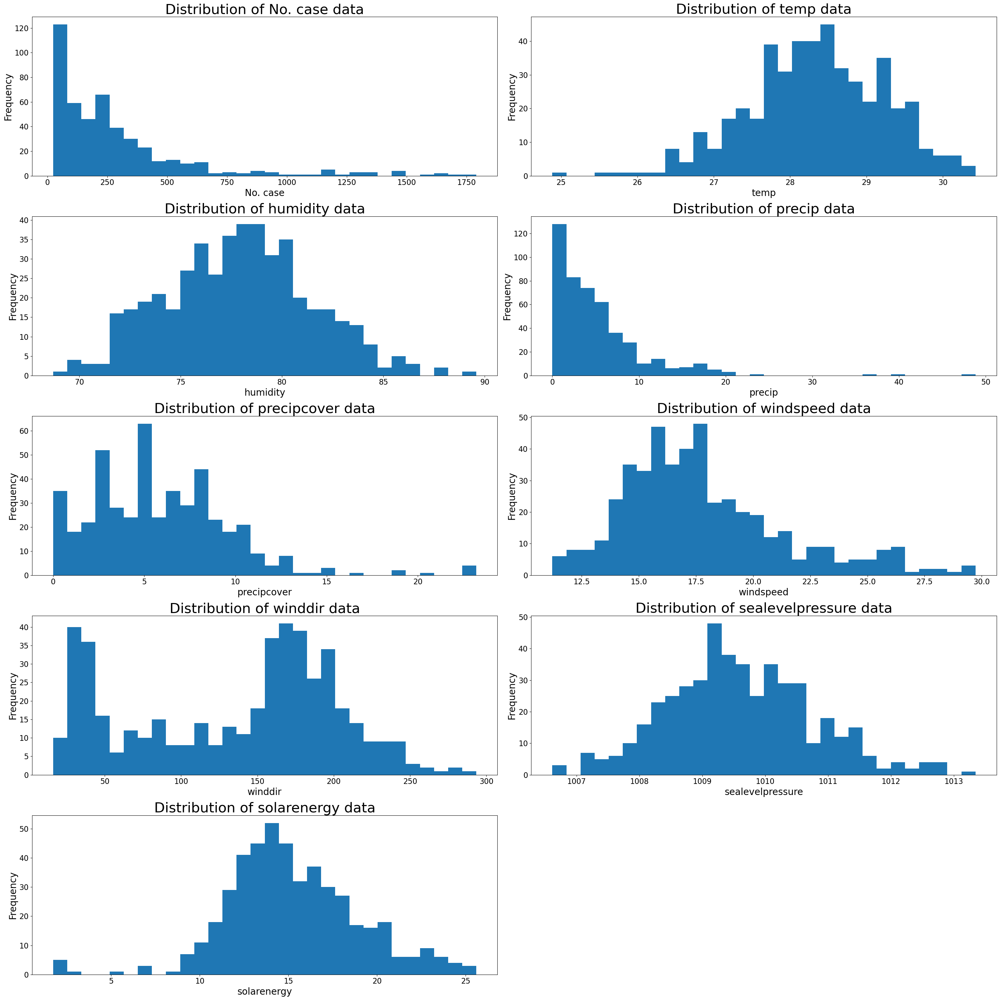

In [74]:
#Creating subplots for each column in reg_df
fig, axs = plt.subplots(5, 2, figsize=(30, 30))

#Loop to plot the distribution of each column values
for i, column in enumerate(dengue_df.columns):
    row = i // 2
    col = i % 2
    axs[row][col].hist(dengue_df[column], bins=30)
    axs[row][col].set_title(f'Distribution of {column} data', fontsize=30)
    axs[row][col].set_xlabel(column, fontsize=20)
    axs[row][col].set_ylabel('Frequency', fontsize=20)
    
    axs[row][col].tick_params(axis='x', labelsize=16)
    axs[row][col].tick_params(axis='y', labelsize=16)

fig.delaxes(axs[4, 1])
fig.tight_layout();

**Conclusion:** 

- Most features seems normally distributed and do not seem to have significant outliers, except for features:
    - tempmax, which is slightly left skewed.
    - precip and precipcover, which are quite significantly right skewed. 
    - windspeed and solarenergy, which are slightly left skewed.
    - winddir, which does not follow 'bell-shaped'.
    - The number of dengue cases data's distribution is right skewed.

- These visualisations suggest quite significant of the data is not normally distributed which might impact certain modelling performance. No actions will be taken for now but attempts to normalise data might take place during modelling process.

- There are several outliers in the data but it will be left in the dataset for now. Further EDA will take place to identify the period where these outliers occur and the choice of training and prediction will not be based on this periods as it suggest sudden shocks which will not be align with usual circumstances.

### Monthly trends

In [75]:
def monthly_plot(feat):
    plt.figure(figsize=(10,5))
    grouped = dengue_df[feat][:-1].groupby(dengue_df[feat][:-1].index.year)

    for year, data in grouped:
        data.groupby(data.index.month).mean().plot(label=year)
        
    months = range(1, 13)  
    month_names = [calendar.month_name[m] for m in months]
    

    plt.title(f'Monthly trend of {feat}')
    plt.xlabel('Month')
    plt.xticks(months, month_names, rotation=45)
    plt.ylabel('Values')    
    plt.legend(loc='upper right')
    plt.tight_layout()

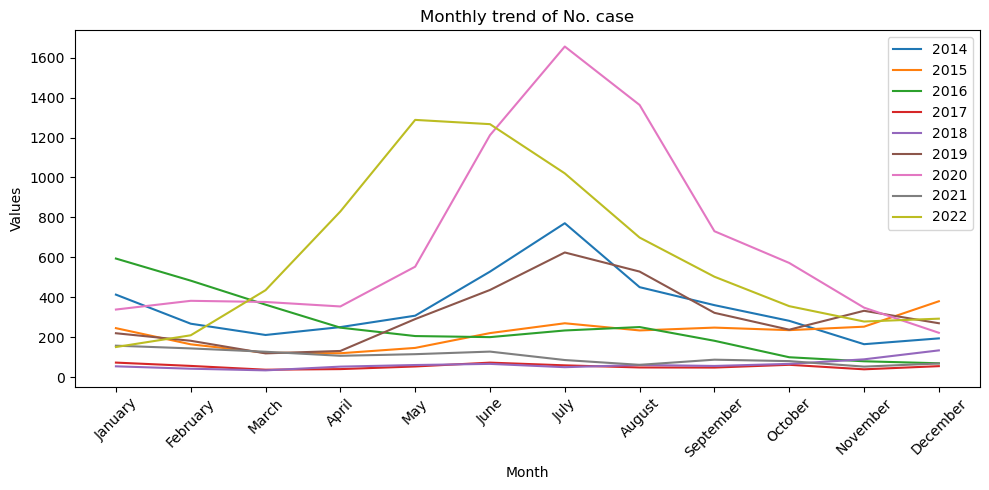

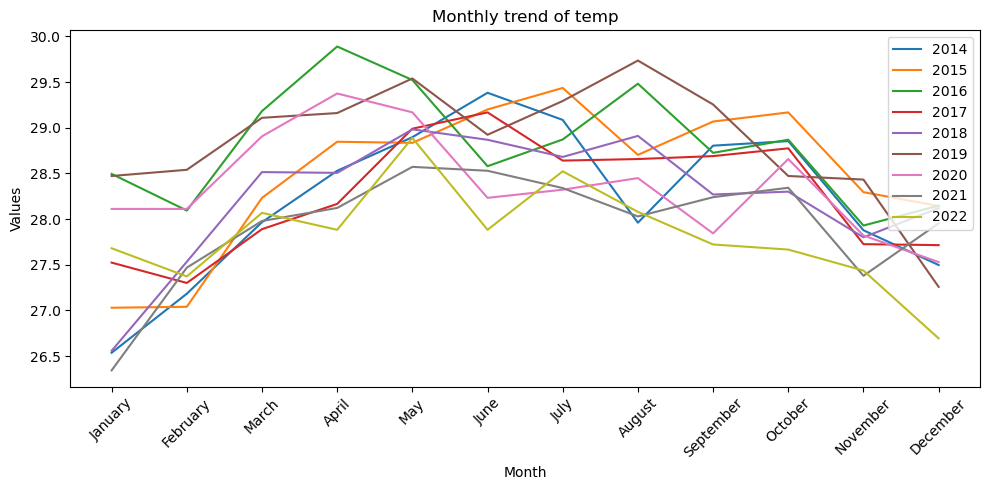

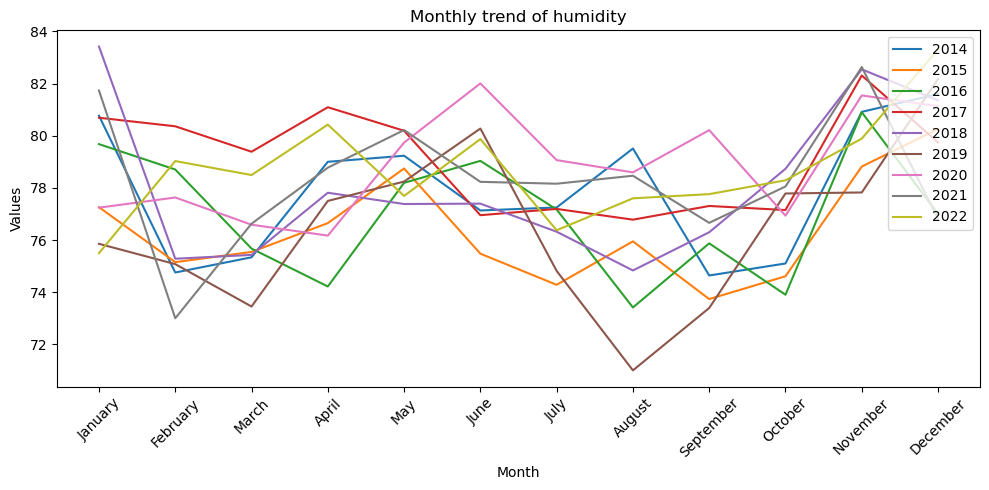

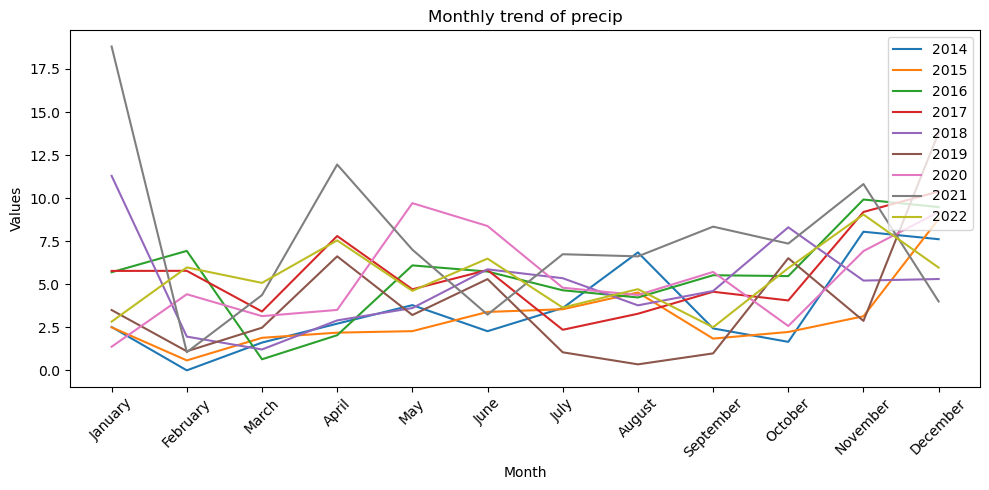

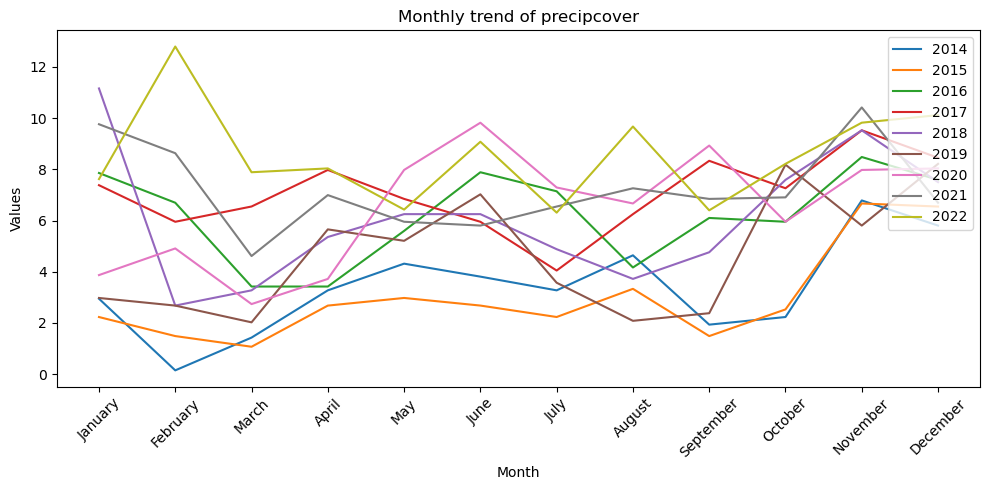

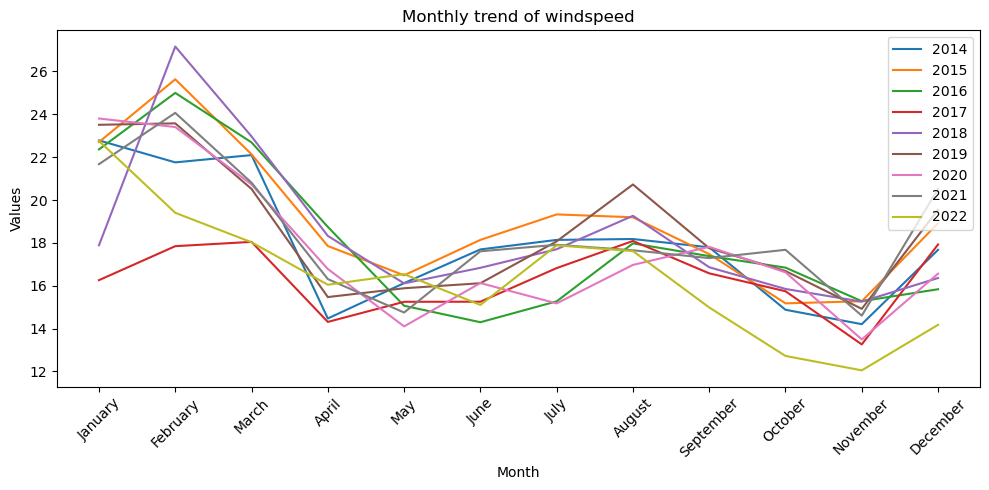

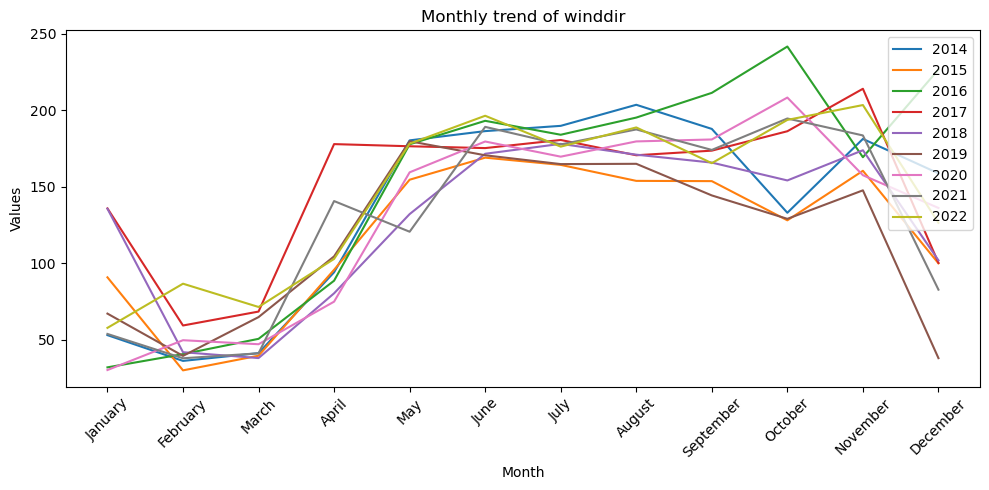

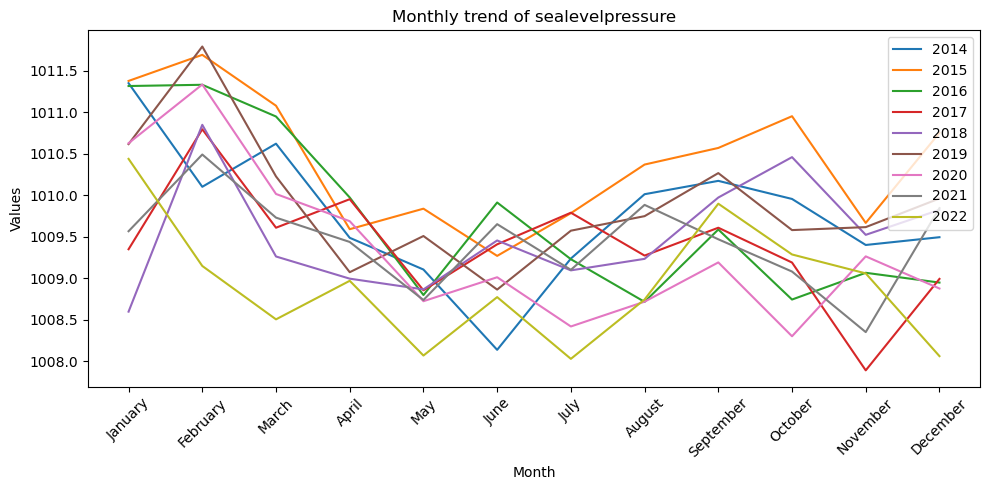

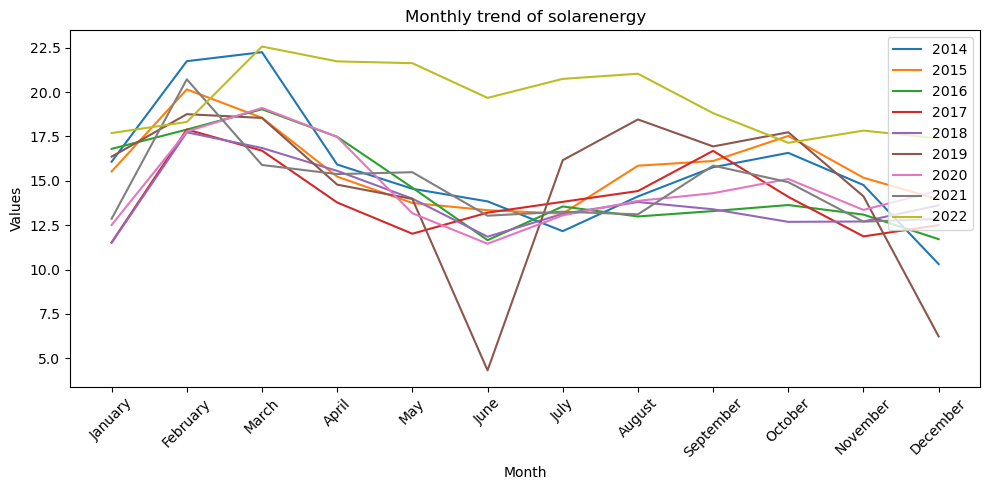

In [76]:
for col in dengue_df.columns:    
    monthly_plot(col)

**Conclusion:**

- There are no consistent pattern of trends on the number of dengue cases throughout the months. It is observed that there are huge spikes of cases in year 2020 and 2022 suggeting that these years might not be ideal for training/prediction using our model.


- Most of the weather features have no consistent monthly trends over the period of 2014 to 2022 except for windspeed and wind direction (i.e winddir). Therefore, if the features, windspeed and winddir, are significant predictors on the number of dengue cases, it will be easier to predict dengue cases since these features exhibit relatively consistent patterns throughout the years.

### Dengue cases VS weather features over time

By plotting against time as well as against each climate feature, it is possible to analyse:
- How the feature behaves over the years.
- The relativeness of change between number of dengue cases and the specific weather feature.

Due to difference in the scale of values, each feature is normalized based on the maximum and minimum values of itself with the use of [MinMaxScaler](https://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.MinMaxScaler.html). This is only for the purpose of visualising the changes of climate features to the number of dengue cases.

The data is also applied with a rolling mean over the period of 12 weeks to provide a clearer visualisation for interpretation. The quarterly window is choosen as it is the most optimal window that provides clarity and meaningful interpretation.

In [77]:
#Normalising the data for visualisation

#Instantiate MinMaxScaler
scaler = MinMaxScaler()

#Creating a dataframe with scaled values
dengue_scaled = scaler.fit_transform(dengue_df)
dengue_df_scaled= pd.DataFrame(dengue_scaled, columns=dengue_df.columns, index=dengue_df.index)

In [78]:
#Overview of the scaled dataset for visualisation
dengue_df_scaled.head()

,No. case,temp,humidity,precip,precipcover,windspeed,winddir,sealevelpressure,solarenergy
datetime,,,,,,,,,
2014-01-05,0.233164,0.363402,0.813826,0.061193,0.251326,0.456173,0.261680,0.565605,0.492280
2014-01-12,0.257499,0.342784,0.818617,0.145528,0.256508,0.440586,0.187165,0.511677,0.375823
2014-01-19,0.213356,0.296392,0.390144,0.000000,0.000000,0.818673,0.041701,0.887473,0.785757
2014-01-26,0.176570,0.188144,0.286790,0.000000,0.000000,0.783951,0.042010,0.851380,0.750449
2014-02-02,0.118846,0.247423,0.202601,0.000000,0.000000,0.564043,0.058402,0.723992,0.915619


In [79]:
#Function to plot the data
def dengue_feat_plot(feat):
    fig, ax = plt.subplots(figsize=(20,10))

    ax.plot(dengue_df_scaled.index, dengue_df_scaled['No. case'].rolling(12).mean(), label='No. of Dengue Cases')
    ax.plot(dengue_df_scaled.index, dengue_df_scaled[feat].rolling(12).mean(), label=feat)
    
    #Adding vertical lines at the start of each year
    for year in range(2014, dengue_df_scaled.index.year.max()+1):
        ax.axvline(x=pd.Timestamp(f'{year}-01-01'), color='gray', linestyle='--', alpha=0.5)

    
    #Setting title
    ax.set_title(f'Number of dengue cases VS {feat}', fontsize=25)

    #Setting labels
    ax.set_xlabel('Periods', fontsize=15)
    ax.set_ylabel('Normalised values', fontsize=15)

    #Formatting of xticks
    month_year_fmt = mdates.DateFormatter('%b %Y')
    ax.xaxis.set_major_locator(mdates.MonthLocator())
    ax.xaxis.set_major_formatter(month_year_fmt)
    fig.autofmt_xdate(rotation=90)
    fig.tight_layout()
    plt.legend();

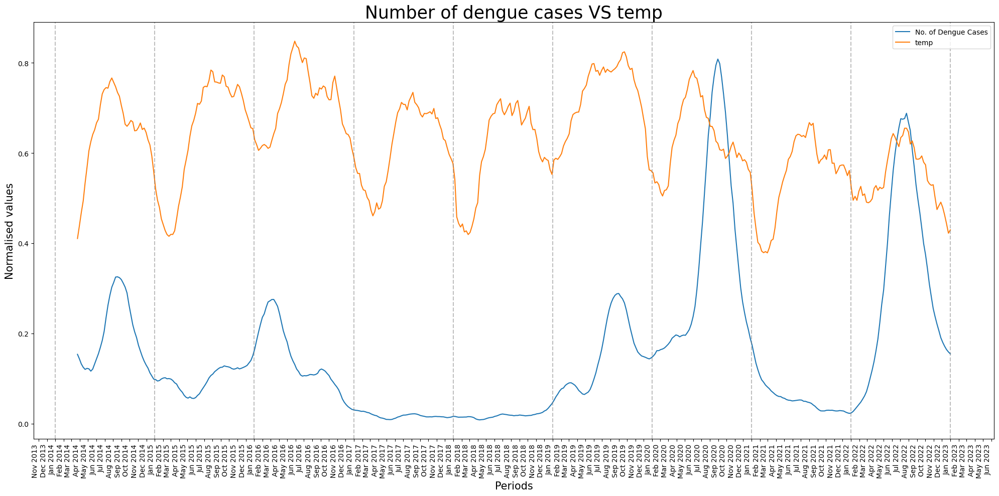

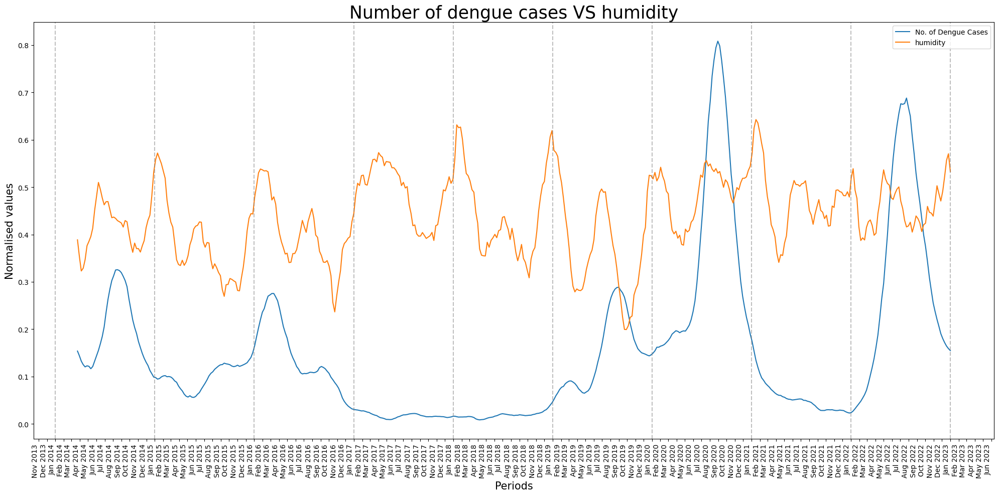

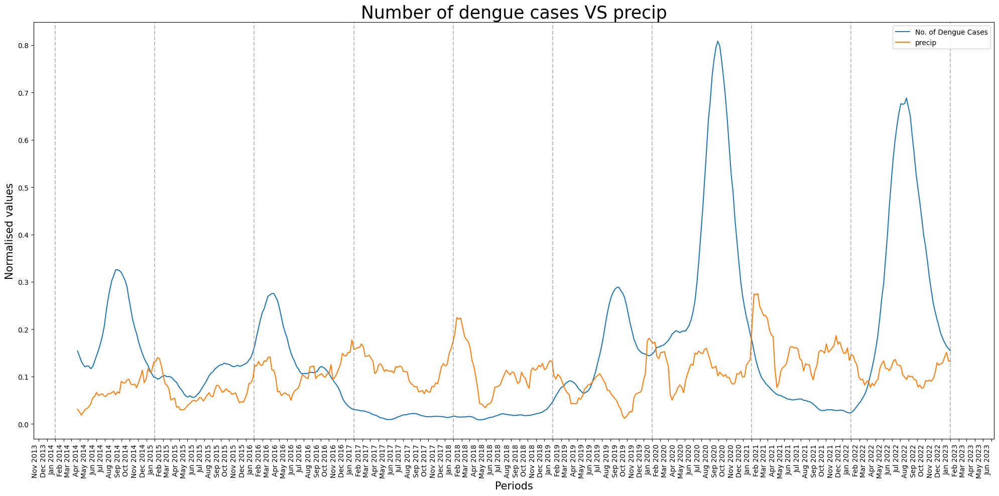

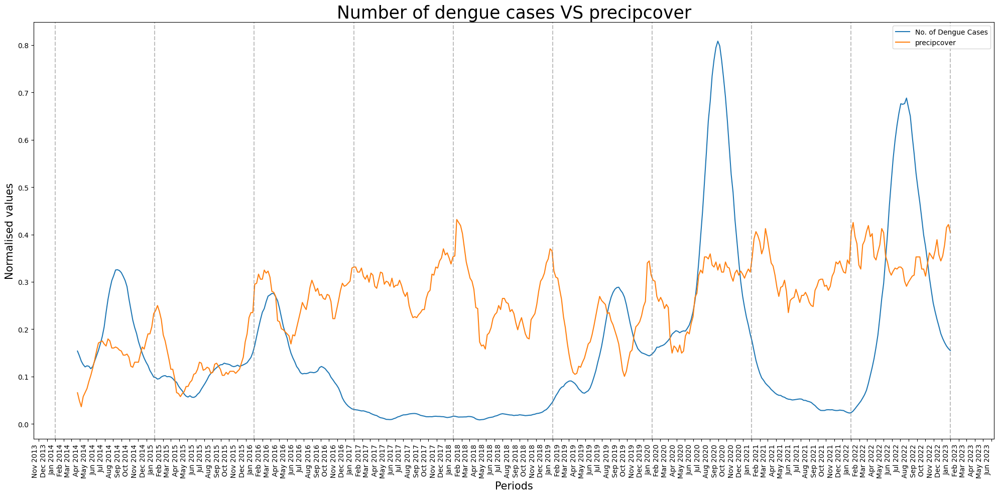

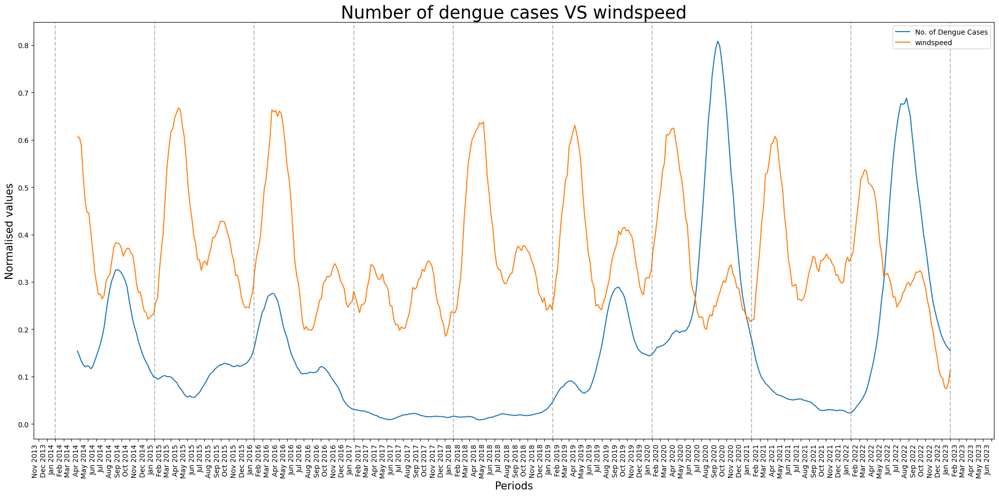

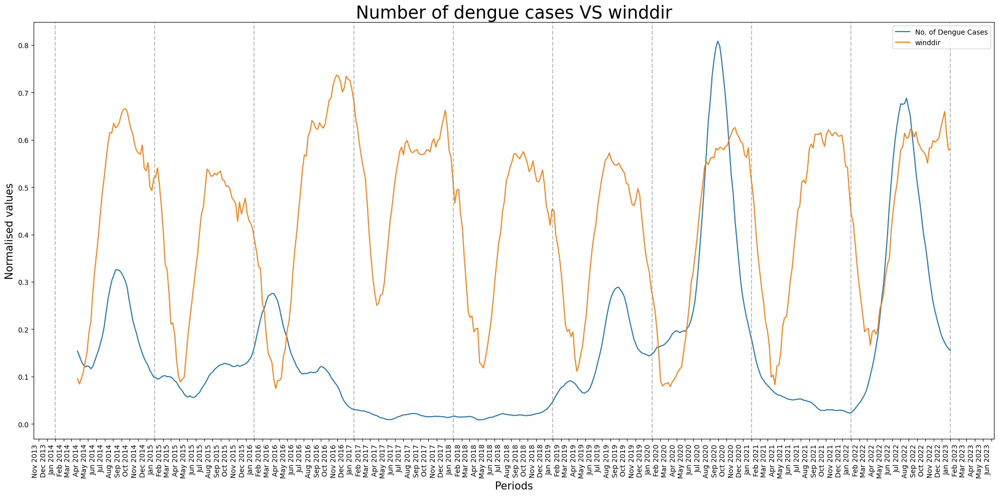

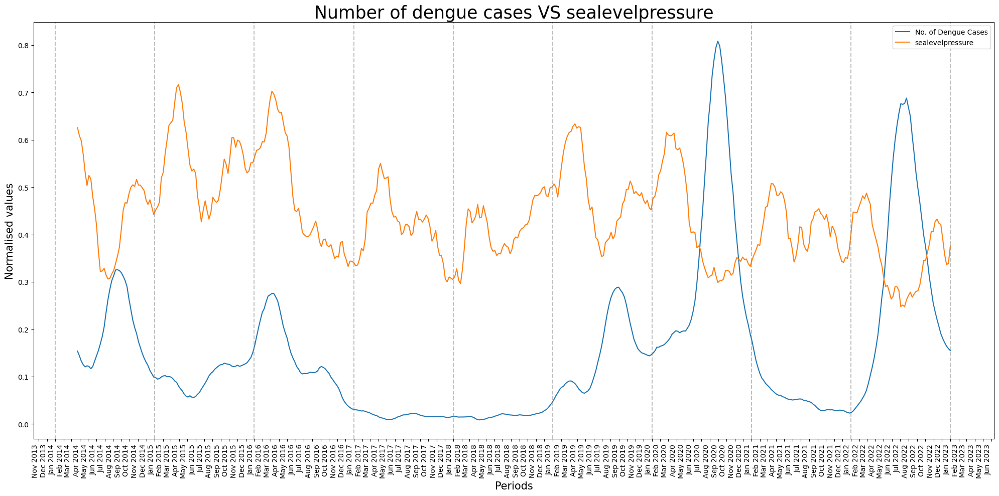

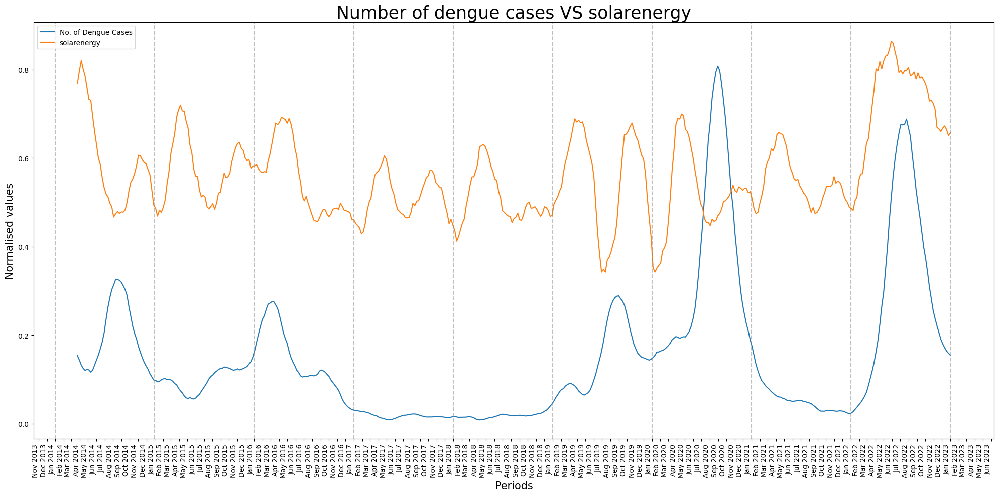

In [80]:
#Plotting visualisation
for i in dengue_df_scaled.columns[1:]:
    dengue_feat_plot(i)

**Conclusion:** 
- There seems to not have specific seasonality to the no. of dengue cases over the years. 
- There are abnormally low amount of cases for the year of 2017 and 2018 where [further research](https://www.straitstimes.com/singapore/2772-dengue-cases-in-2017-the-lowest-in-the-last-16-years-nea) have contributed the reasons to:
    - Community build-up of immunity over past years dengue outbreak
    - More rigourous inspections and community cooperation due to Zika outbreak in the [second half of 2016](https://edition.cnn.com/2016/09/05/health/zika-asia-threat/index.html)
    - Lauch of [Gravitraps](https://www.nea.gov.sg/media/nea-vox/index/why-is-nea-placing-mosquito-traps-outside-my-house-will-this-increase-my-chances-of-being-bitten-by-mosquitoes), a form of mosquito vector control method, to capture and identification of hotspots

- There are abnormally high amount of cases for the year 2020 and 2022 where NEA contributed due to [high Aedes mosquito population and uptick in DenV-3 infections](https://killem.com.sg/blog/dengue-cases-in-singapore-increase-by-more-than-500-in-2022/#:~:text=According%20to%20the%20NEA%2C%20the,incubation%20cycles%20of%20the%20mosquito.) in 2022 and also due to [COVID-19 circuit breaker measures which kept most individuals at home where bites often take place](https://www.ncid.sg/Health-Professionals/Articles/Pages/Epidemic-Dengue-in-Singapore-During-COVID-19-Pandemic.aspx#:~:text=The%20increase%20in%20work%2Dfrom,the%20surge%20in%20dengue%20cases.) in 2020.

### Correlation between weather features and number of dengue cases

Using pearson's correlation to understand if there is signs of correlation between the features and the number of dengue cases. 

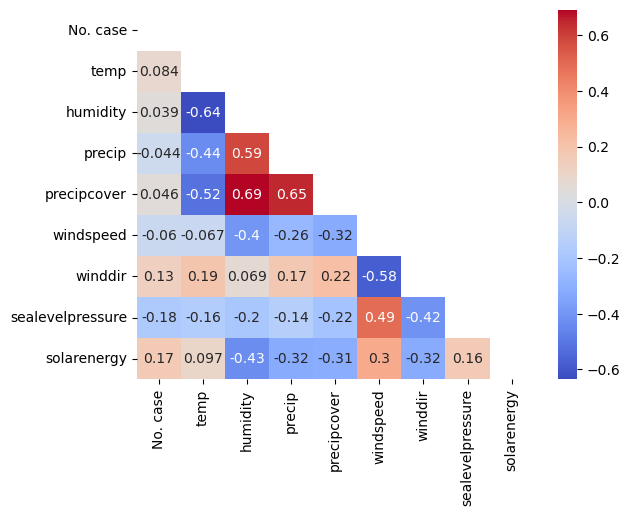

In [81]:
#Heatmap of correlation between features
corr_df=dengue_df.corr()
mask = np.zeros_like(dengue_df.corr())
mask[np.triu_indices_from(mask)] = True
sns.heatmap(corr_df, mask=mask, cmap='coolwarm', annot=True);

**Conclusion:** All weather features display very weak correlation to the number of dengue cases. Understanding that it takes about [10 days for an Aedes mosquito to develop from its egg to laying eggs](https://www.nea.gov.sg/dengue-zika/prevent-aedes-mosquito-breeding/aedes-mosquito#:~:text=Under%20optimal%20conditions,the%20cycle%20repeats.), thus weather features will be lag by 2 weeks to take this into account. Additionally, we will filter the years that have abnormal results and the correlation will be computed.

In [82]:
#Lagging only the weather features by 2 weeks
dengue_shift=dengue_df.copy()
dengue_shift[dengue_shift.columns[1:]]=dengue_shift[dengue_shift.columns[1:]].shift(2)
dengue_shift.dropna(axis=0,inplace=True)

In [83]:
#Filtering years of data with less anomalies
years_to_filter = [2014, 2015, 2016, 2019, 2021]
filtered_data = dengue_shift[dengue_shift.index.year.isin(years_to_filter)]

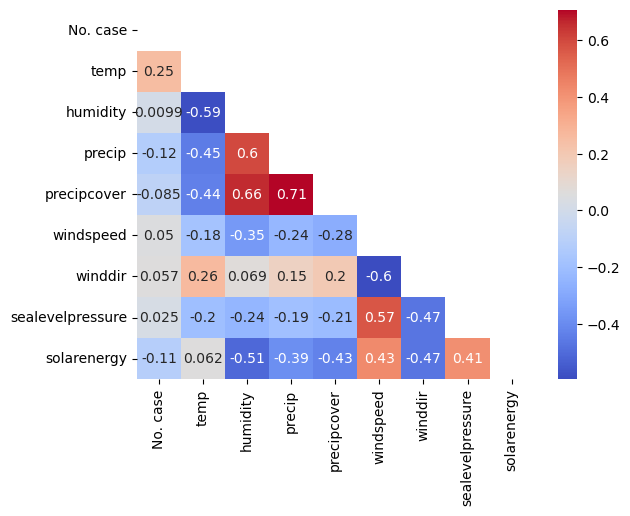

In [84]:
#Heatmap of correlation between features with lag of 2 weeks
corr_df=filtered_data.corr()
sns.heatmap(corr_df, mask=mask, cmap='coolwarm', annot=True);

**Conclusion:** Still there isn't much significant correlation between weather features and the number of dengue cases. This suggest that there are other determinants that also influence the number of dengue cases. Further readings have also attribute that population size and density as well as household's awareness and dilligence in wiping out aedes mosquito's breeding environment can impact the number of cases significantly.

### Correlation between Google trend search and Dengue cases

To analyze if there is strong relatonship between Google trend search and the number of dengue cases. The plots are roll forward by 2 weeks and aggregated by its mean to smoothen out the visualisation for easier comparison.

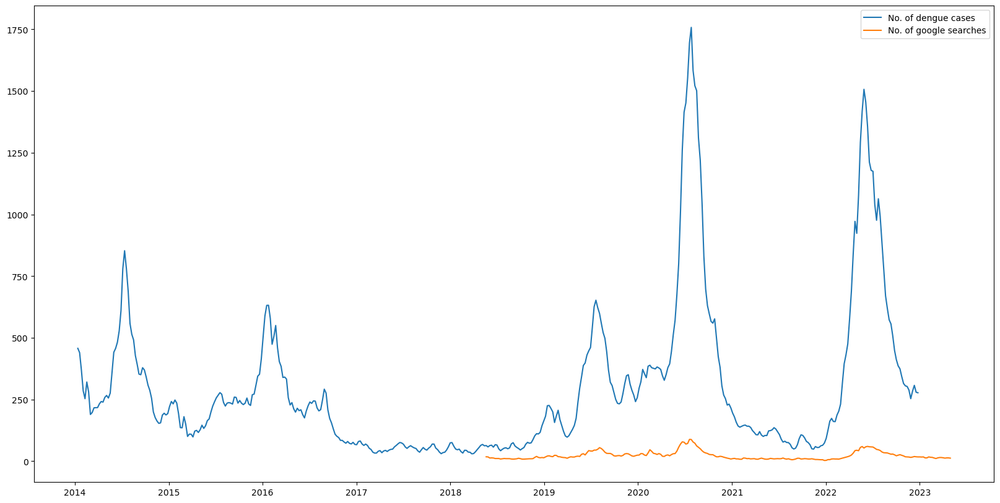

In [110]:
plt.figure(figsize=(20,10))
plt.plot(dengue_weekly['No. case'].rolling(2).mean(), label='No. of dengue cases')
plt.plot(google_trend_df['No. weekly search'].rolling(2).mean(), label='No. of google searches')
plt.legend();

**Conclusion:**
- Despite there are similar peaks over the same time period between the number of dengue cases and google trend searches, the changes are insiginficant.
- Additionally, even if the google trend searches are to be siginficant exogeneous factors in determining dengue cases, it would not be possible to access future amount of google searches on the topic of dengue to use it as a feature to predict future amount of dengue cases.

### Geographical visualisation of Dengue Clusters over time

To analyse visually the geographical location of reported dengue cases and the intensity of these cases within clusters monthly. 

Dengue cluster data set is obatained from [SGcharts](http://outbreak.sgcharts.com/data). The formatting work on the dataset only includes grouping the clusters by months and their respective years in order for [TimestampedGeoJson](https://python-visualization.github.io/folium/plugins.html#:~:text=class%20folium.plugins.-,TimestampedGeoJson,-(data%2C) to visualise the geographical region of clusters with respect to time.

The dengue cluster dataset only starts from Oct 2014 onwards till May 2020 due to incomplete collection. Nonetheless, it coincides with most of the period of time of our weather and dengue dataset.

In [31]:
df_list=[]
#To conveniently create a list of csv names to be imported for cocatenating
for i in ['14','15','16','17','18','19','20']:  
    path = f"assets/cluster_data/20{i}/{i}*.csv"
    all_files = glob.glob(path)

    li = []
    for filename in all_files:
        #To assign appropriate column names and creating a column that captures the year and month of the clusters
        df = pd.read_csv(filename, names=['No. Cases', 'Address', 'lat', 'long', 'Cluster serial', 'recent', 'total cluster', 'date', 'month'])
        df['date']=pd.to_datetime(df['date'], format='%y%m%d')
        df['month_year']=df['date'].dt.strftime('%Y-%m')
        df['month_year']=pd.to_datetime(df['month_year'], format='%Y-%m')
        li.append(df)

    #Concatenating all dataframes to a year 
    globals()[f'c20{i}_df'] = pd.concat(li, axis=0, ignore_index=True)

In [32]:
#Concatenating each yearly cluster dataset into a main dataset, clust_df
clust_df=pd.concat([c2014_df, c2015_df, c2016_df, c2017_df, c2018_df, c2019_df, c2020_df], axis=0)

In [33]:
#Overview of first few rows of clust_df
clust_df.head()

,No. Cases,Address,lat,long,Cluster serial,recent,total cluster,date,month,month_year
0,7,corporation road,1.338061,103.717015,1,11,28,2014-10-13,10,2014-10-01
1,1,jurong west street 52 (block 517c),1.344936,103.719972,1,11,28,2014-10-13,10,2014-10-01
2,1,jurong west street 52 (block 517e),1.344534,103.718836,1,11,28,2014-10-13,10,2014-10-01
3,13,jurong west street 52 (block 518),1.345138,103.717968,1,11,28,2014-10-13,10,2014-10-01
4,3,jurong west street 52 (block 520),1.345960,103.718169,1,11,28,2014-10-13,10,2014-10-01


In [34]:
#Sorting location by largest clusters
print('Highest amount of clusters by location')
print('-------------------------------------')
print(clust_df.groupby('Address')['total cluster'].sum().sort_values(ascending=False)[:10])

#Sorting location by largest clusters besides choa chu kang
print('\n Highest amount of clusters by location besides choa chu kang')
print('-------------------------------------')
temp_clust=clust_df.loc[~clust_df['Address'].str.contains('choa chu kang')]
print(temp_clust.groupby('Address')['total cluster'].sum().sort_values(ascending=False)[:10])

Highest amount of clusters by location
-------------------------------------
Address
choa chu kang avenue 2 (block 297c)    7636
choa chu kang avenue 2 (block 297)     7541
choa chu kang avenue 2 (block 296)     7512
choa chu kang avenue 2 (block 296b)    7231
choa chu kang avenue 2 (block 296a)    7089
choa chu kang avenue 2 (block 297a)    5904
choa chu kang avenue 2 (block 297d)    5875
choa chu kang avenue 2 (block 296e)    5857
choa chu kang avenue 2 (block 296d)    5691
choa chu kang avenue 3 (block 406)     5126
Name: total cluster, dtype: int64

 Highest amount of clusters by location besides choa chu kang
-------------------------------------
Address
geylang road         4794
keat hong close      4331
guillemard road      4187
lorong 22 geylang    2965
sims avenue          2838
begonia drive        2554
kasai road           2523
saraca road          2448
mimosa crescent      2417
saraca view          2410
Name: total cluster, dtype: int64


Most frequent clusters are occuring around the area of Choa Chu Kang. Besides the clusters in Choa Chu Kang, other areas that display frequent clusters are around:
 - Geylang road 
 - Saraca road 
 - Buangkok
 - Tampines avenue 4 

In [36]:
#Plotting the geographical region of the clusters with respect to time

#Create a map object of Singapore
map_obj = folium.Map(location=[1.3521, 103.8198], min_zoom=13, max_zoom=13)


#Defining function to set color on no. of cases in each cluster
def get_color(cases):
    if cases < 3:
        return 'green'
    elif cases < 10:
        return 'orange'
    else:
        return 'red'

clust_dict={'Choa Chu Kang':[1.378458, 103.743098], 'Geylang':[1.3201, 103.8918], 
            'Saraca & Buangkok':[1.387857,103.863388], 'Tampines':[1.346824, 103.938415]}
   
for text, location in clust_dict.items():
    folium.CircleMarker(
        location=location,
        radius=100,  
        color='blue',
        fill_color='blue',
        fill_opacity=0.2).add_to(map_obj)
    folium.Marker(location=location, popup=text).add_to(map_obj)
    
#List to store the data points
data = []

#Setting up dictionary of features 
for index, row in clust_df.iterrows():
    data.append({
        'type': 'Feature',
        'geometry': {
            'type': 'Point',
            'coordinates': [row['long'], row['lat']],
        },
        'properties': {
            'time': row['month_year'].isoformat(),
            'icon': 'circle',
            'iconstyle': {
                'color': get_color(row['No. Cases']),
                'opacity': 0.5,
                'fill_opacity':0.5,
                'radius': 5}}})

# Add the TimestampedGeoJson layer to the map
TimestampedGeoJson({'type': 'FeatureCollection', 'features': data},
                    period='P1M',  
                    add_last_point=True,
                    auto_play=False,
                    loop=False,
                    max_speed=30,
                    loop_button=True,
                    duration='P1M',
                    date_options='YYYY-MM-DD',
                    time_slider_drag_update=True
                   ).add_to(map_obj)

# Display the map
map_obj


As observed above in the folium's map, the blue rings denotes the area of frequent clusters identified previously. Green rings (< 3 dengue cases), orange rings (4 to 10 dengue cases), red rings (> 10 cases) are also plotted on the map to have an understanding on the intensity of dengue cases geographically. 

It is observed that the clusters peak at different periods throughout the years
 - Choa Chu Kang peaks in 2014 and 2020 and have consistent dengue cases in the area.
 - Saraca and Buangkok peaks only in 2016, 2019 and 2020.
 - Geylang peaks in 2014, 2016 and 2019 and have consistent dengue cases throughout the years.
 - Tampines peaks ardound 2015 and 2016 and have lesser amount of cases than other frequent clusters during the peaks in 2020.

This also reflects the success of the Wolbachia-Aedes Mosquito Suppression Strategy implemented since 2016 in Tampines which negates the number of dengue cases during peak seasons/years.

## Export of CSV

In [586]:
dengue_df.to_csv('dengue_df.csv', index=True)